In [1]:
import os
import cv2
import zipfile
import requests
import numpy as np


In [2]:
import absl
import logging
import warnings
import glob as glob
import tensorflow_hub as hub
import matplotlib.pyplot as plt

In [3]:
warnings.filterwarnings("ignore",module='absl')
logging.captureWarnings(True)
absl_logger = logging.getLogger('absl')
absl_logger.setLevel(logging.ERROR)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

In [4]:
path_image = r'C:\Users\dhika\Downloads\object_detection_images\object_detection_images'
path_image = sorted(glob.glob(os.path.join(path_image,'*png')))
for idx in range (len(path_image)):
    print(path_image[idx])

C:\Users\dhika\Downloads\object_detection_images\object_detection_images\dog_bicycle_car.png
C:\Users\dhika\Downloads\object_detection_images\object_detection_images\elephants.png
C:\Users\dhika\Downloads\object_detection_images\object_detection_images\home_interior.png
C:\Users\dhika\Downloads\object_detection_images\object_detection_images\place_setting.png


In [5]:
def image_load(path):
    image=cv2.imread(path)
    image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
    image=np.expand_dims(image,axis=0)
    return image

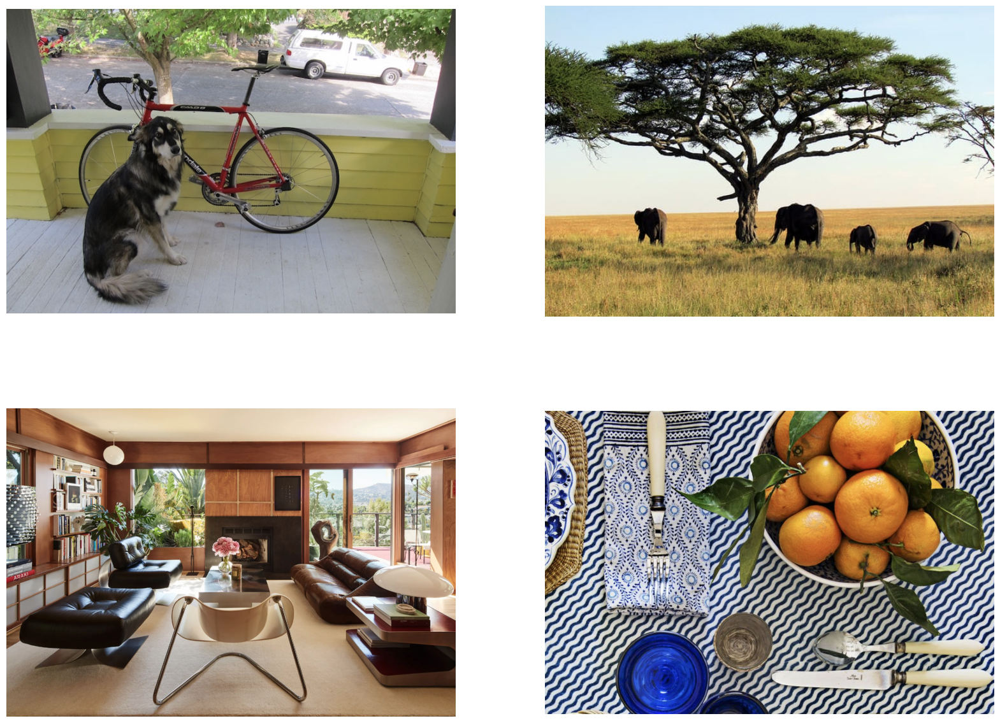

In [6]:
img = []
fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(20,15))
idx=0
for axis in ax.flat:
    image=image_load(path_image[idx])
    img.append(image)
    axis.imshow(image[0])
    axis.axis('off')
    idx+=1

In [7]:
index_classes =  \
{
         1: 'person',
         2: 'bicycle',
         3: 'car',
         4: 'motorcycle',
         5: 'airplane',
         6: 'bus',
         7: 'train',
         8: 'truck',
         9: 'boat',
         10: 'traffic light',
         11: 'fire hydrant',
         13: 'stop sign',
         14: 'parking meter',
         15: 'bench',
         16: 'bird',
         17: 'cat',
         18: 'dog',
         19: 'horse',
         20: 'sheep',
         21: 'cow',
         22: 'elephant',
         23: 'bear',
         24: 'zebra',
         25: 'giraffe',
         27: 'backpack',
         28: 'umbrella',
         31: 'handbag',
         32: 'tie',
         33: 'suitcase',
         34: 'frisbee',
         35: 'skis',
         36: 'snowboard',
         37: 'sports ball',
         38: 'kite',
         39: 'baseball bat',
         40: 'baseball glove',
         41: 'skateboard',
         42: 'surfboard',
         43: 'tennis racket',
         44: 'bottle',
         46: 'wine glass',
         47: 'cup',
         48: 'fork',
         49: 'knife',
         50: 'spoon',
         51: 'bowl',
         52: 'banana',
         53: 'apple',
         54: 'sandwich',
         55: 'orange',
         56: 'broccoli',
         57: 'carrot',
         58: 'hot dog',
         59: 'pizza',
         60: 'donut',
         61: 'cake',
         62: 'chair',
         63: 'couch',
         64: 'potted plant',
         65: 'bed',
         67: 'dining table',
         70: 'toilet',
         72: 'tv',
         73: 'laptop',
         74: 'mouse',
         75: 'remote',
         76: 'keyboard',
         77: 'cell phone',
         78: 'microwave',
         79: 'oven',
         80: 'toaster',
         81: 'sink',
         82: 'refrigerator',
         84: 'book',
         85: 'clock',
         86: 'vase',
         87: 'scissors',
         88: 'teddy bear',
         89: 'hair drier',
         90: 'toothbrush'
}

In [8]:
R = np.array (np.arange(96,256,32))
G = np.roll(R,1)
B = np.roll(R,2)
COLOR_IDS = np.array(np.meshgrid(R,G,B)).T.reshape(-1,3)
print(COLOR_IDS)

[[ 96 224 192]
 [ 96  96 192]
 [ 96 128 192]
 [ 96 160 192]
 [ 96 192 192]
 [128 224 192]
 [128  96 192]
 [128 128 192]
 [128 160 192]
 [128 192 192]
 [160 224 192]
 [160  96 192]
 [160 128 192]
 [160 160 192]
 [160 192 192]
 [192 224 192]
 [192  96 192]
 [192 128 192]
 [192 160 192]
 [192 192 192]
 [224 224 192]
 [224  96 192]
 [224 128 192]
 [224 160 192]
 [224 192 192]
 [ 96 224 224]
 [ 96  96 224]
 [ 96 128 224]
 [ 96 160 224]
 [ 96 192 224]
 [128 224 224]
 [128  96 224]
 [128 128 224]
 [128 160 224]
 [128 192 224]
 [160 224 224]
 [160  96 224]
 [160 128 224]
 [160 160 224]
 [160 192 224]
 [192 224 224]
 [192  96 224]
 [192 128 224]
 [192 160 224]
 [192 192 224]
 [224 224 224]
 [224  96 224]
 [224 128 224]
 [224 160 224]
 [224 192 224]
 [ 96 224  96]
 [ 96  96  96]
 [ 96 128  96]
 [ 96 160  96]
 [ 96 192  96]
 [128 224  96]
 [128  96  96]
 [128 128  96]
 [128 160  96]
 [128 192  96]
 [160 224  96]
 [160  96  96]
 [160 128  96]
 [160 160  96]
 [160 192  96]
 [192 224  96]
 [192  96 

In [9]:
DetEfficient  = {'EfficientDet D0 512x512'   : 'https://tfhub.dev/tensorflow/efficientdet/d0/1',
                 'EfficientDet D1 640x640'   : 'https://tfhub.dev/tensorflow/efficientdet/d1/1',
                 'EfficientDet D2 768x768'   : 'https://tfhub.dev/tensorflow/efficientdet/d2/1',
                 'EfficientDet D3 896x896'   : 'https://tfhub.dev/tensorflow/efficientdet/d3/1',
                 'EfficientDet D4 1024x1024' : 'https://tfhub.dev/tensorflow/efficientdet/d4/1',
                 'EfficientDet D5 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d5/1',
                 'EfficientDet D6 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d6/1',
                 'EfficientDet D7 1536x1536' : 'https://tfhub.dev/tensorflow/efficientdet/d7/1'
                }

In [10]:
model_url = DetEfficient['EfficientDet D4 1024x1024' ]
print('loading model: ', model_url)
od_model = hub.load(model_url)
print('\nmodel loaded!')

loading model:  https://tfhub.dev/tensorflow/efficientdet/d4/1

model loaded!


In [11]:
results = od_model(img[0])
results = {key:value.numpy() for key, value in results.items()}
for key in results:
    print(key)

detection_boxes
raw_detection_boxes
raw_detection_scores
detection_anchor_indices
detection_classes
detection_scores
num_detections
detection_multiclass_scores


In [12]:
print('Raw Detections: ', (len(results['raw_detection_scores'][0])))
print('Num Detections: ', (results['num_detections'][0]))

Raw Detections:  196416
Num Detections:  100.0



Detection Score:
 [0.90535027 0.8788446  0.72016716 0.35485467 0.2805571  0.17855306
 0.15184233 0.14899154 0.14454454 0.1358745  0.12683801 0.1175383
 0.10780691 0.10143129 0.10053901 0.09749641 0.0934275  0.09315746
 0.09095422 0.08784332 0.08296677 0.08287327 0.08103886 0.07872337
 0.07778949 0.07528756 0.07296043 0.0716261  0.07001206 0.06870757
 0.06793442 0.06610467 0.06538816 0.06441722 0.06098075 0.05956643
 0.05941277 0.05915442 0.05849694 0.05818762 0.05795335 0.05780691
 0.05769771 0.05751209 0.05749007 0.05706437 0.05704255 0.05582926
 0.05509287 0.05506517 0.05459499 0.05444354 0.05371371 0.05336666
 0.05326932 0.05101385 0.05095809 0.0495903  0.04954726 0.04777961
 0.04754922 0.04722304 0.04684898 0.04678523 0.04628324 0.04583958
 0.04571375 0.04528115 0.04519491 0.04497242 0.04449563 0.04327953
 0.0430063  0.04217248 0.04137905 0.0410323  0.04085487 0.04062966
 0.04058143 0.04029127 0.04010503 0.03931701 0.039202   0.03854334
 0.03827722 0.03814982 0.03808155 0.03789091

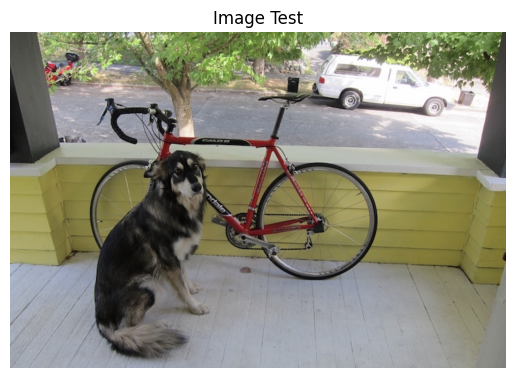

In [13]:
det_nums = (results['num_detections'][0]).astype(int)
print('\nDetection Score:\n',results['detection_scores'][0][0:det_nums])
print('\nClass Detected:\n',results['detection_classes'][0][0:det_nums])
print('\nBoxes Detectes:\n',results['detection_boxes'][0][0:det_nums])

detected_classes = [index_classes[i] for i in results['detection_classes'][0][0:det_nums]]
print('\nClass Detected:\n', detected_classes)

import matplotlib.image as mpimg
img_path = r"C:\\Users\\dhika\\Downloads\\object_detection_images\\object_detection_images\\dog_bicycle_car.png"
img = mpimg.imread(img_path)
plt.title('Image Test')
plt.axis('Off')
plt.imshow(img)
plt.show()

In [14]:
def process_det(image,results,min_det_thresh=.5):
    
    scores = results['detection_scores'][0]
    boxes = results['detection_boxes'][0]
    classes = (results['detection_classes'][0]).astype(int)
    
    min_det_thresh = min_det_thresh
    indices_det = np.where (scores>=min_det_thresh)[0]
    
    scores_thres = scores[indices_det]
    boxes_thres = boxes[indices_det]
    classes_thres = classes[indices_det]

    font_scale = .6
    box_thickness = 2

    img_bbox = image.copy()
    im_height,im_width = image.shape[:2]
    
    for box, class_id, score in zip(boxes_thres,classes_thres,scores_thres):
        ymin,xmin,ymax,xmax = box
        class_name = index_classes[class_id]

        (left,right,top,bottom) = (int(xmin*im_width),
                                   int(xmax*im_width),
                                   int(ymin*im_height),
                                   int(ymax*im_height))
        
        color = tuple(COLOR_IDS[class_id % len(COLOR_IDS)].tolist())[::-1]
        img_bbox = cv2.rectangle(img_bbox,(left,top),(right,bottom), color, thickness=box_thickness)

        display_txt = '{}:{:.2f}%'.format(class_name,100*score)
        ((text_width,text_height),_) = cv2.getTextSize(display_txt,cv2.FONT_HERSHEY_SIMPLEX,font_scale,1)

        if top < text_height:
            shift_down = int(2*(1.3*text_height))
        else :
            shift_down =0

        img_bbox = cv2.rectangle (img_bbox,
                                  (left-1, top-box_thickness-int(1.3*text_height)+shift_down),
                                  (left-1+int(1.1*text_width),top),
                                  color=(0,0,0),
                                  thickness=-1)
        
        img_bbox = cv2.putText(img_bbox,
                               display_txt,
                               (left + int(.05*text_width), top - int(0.2*text_height)+int(shift_down/2)),
                               cv2.FONT_HERSHEY_SIMPLEX, font_scale,(255,255,255),1)
        
    return img_bbox

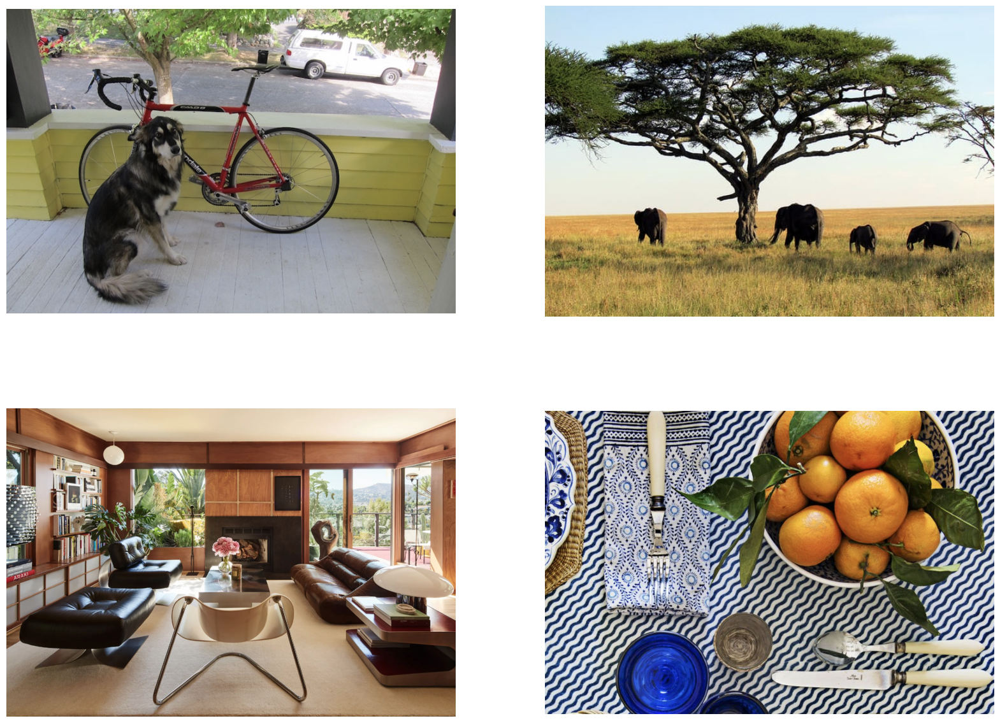

In [15]:
img = []
fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(20,15))
idx=0
for axis in ax.flat:
    image=image_load(path_image[idx])
    img.append(image)
    axis.imshow(image[0])
    axis.axis('off')
    idx+=1

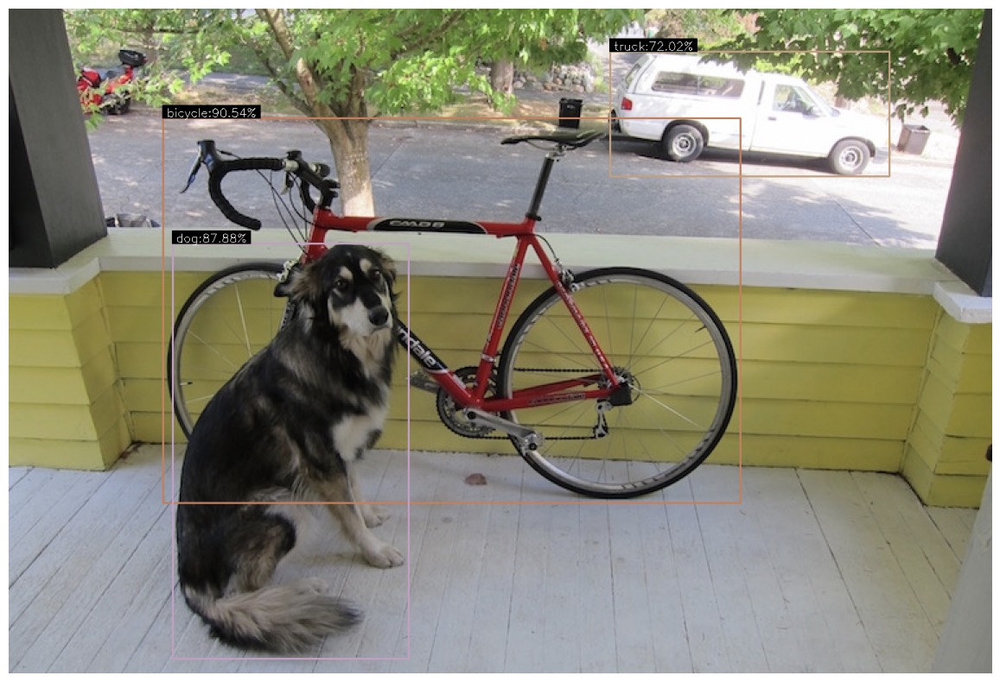

In [16]:
results = od_model(img[0])
results = {key:value.numpy() for key, value in results.items()}
image = np.squeeze(img[0])
img_bbox = process_det(image, results, min_det_thresh=0.5)

plt.figure(figsize=[15, 10])
plt.imshow(img_bbox)
plt.axis('off');

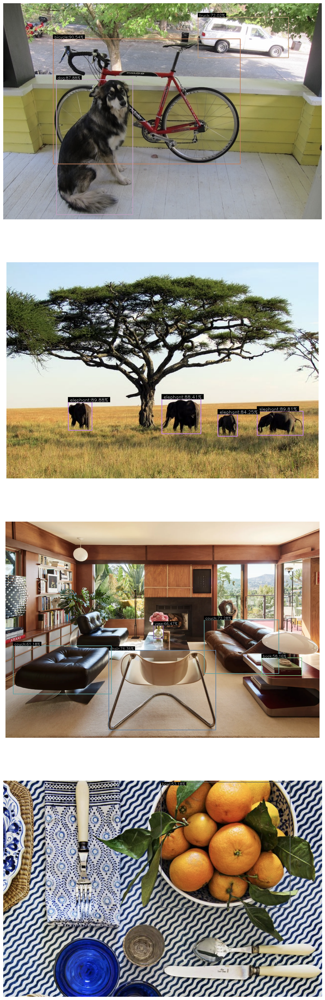

In [17]:
fig, axs = plt.subplots(nrows=len(img), figsize=[15, 10*len(img)])
for i, img in enumerate(img):
    results = od_model(img)
    results = {key:value.numpy() for key, value in results.items()}
    image = np.squeeze(img)
    img_bbox = process_det(image, results, min_det_thresh=0.5)

    axs[i].imshow(img_bbox)
    axs[i].axis('off')
plt.show()

In [18]:
def process_det_person(image, results, min_det_thresh=.5):
    person_count = 0    
    scores = results['detection_scores'][0]
    boxes = results['detection_boxes'][0]
    classes = (results['detection_classes'][0]).astype(int)
    
    min_det_thresh = min_det_thresh
    indices_det = np.where (scores>=min_det_thresh)[0]
    

    scores_thres = scores[indices_det]
    boxes_thres = boxes[indices_det]
    classes_thres = classes[indices_det]

    font_scale = .6
    box_thickness = 2

    img_bbox = image.copy()
    im_height,im_width = image.shape[:2]
    
    for box, class_id, score in zip(boxes_thres,classes_thres,scores_thres):
        ymin,xmin,ymax,xmax = box
        class_name = index_classes[class_id]

        if class_name == 'person':
            person_count += 1

            (left,right,top,bottom) = (int(xmin*im_width),
                                       int(xmax*im_width),
                                       int(ymin*im_height),
                                       int(ymax*im_height))
            
            color = tuple(COLOR_IDS[class_id % len(COLOR_IDS)].tolist())[::-1]
            img_bbox = cv2.rectangle(img_bbox,(left,top),(right,bottom), color, thickness=box_thickness)

            display_txt = '{}:{:.2f}%'.format(class_name,100*score)
            ((text_width,text_height),_) = cv2.getTextSize(display_txt,cv2.FONT_HERSHEY_SIMPLEX,font_scale,1)

            if top < text_height:
                shift_down = int(2*(1.3*text_height))
            else :
                shift_down =0

            img_bbox = cv2.rectangle (img_bbox,
                                      (left-1, top-box_thickness-int(1.3*text_height)+shift_down),
                                      (left-1+int(1.1*text_width),top),
                                      color=(0,0,0),
                                      thickness=-1)
            
            img_bbox = cv2.putText(img_bbox,
                                   display_txt,
                                   (left + int(.05*text_width), top - int(0.2*text_height)+int(shift_down/2)),
                                   cv2.FONT_HERSHEY_SIMPLEX, font_scale,(255,255,255),1)
    print('Total Person Detected:', person_count)
    return person_count, img_bbox

Total Person Detected: 42


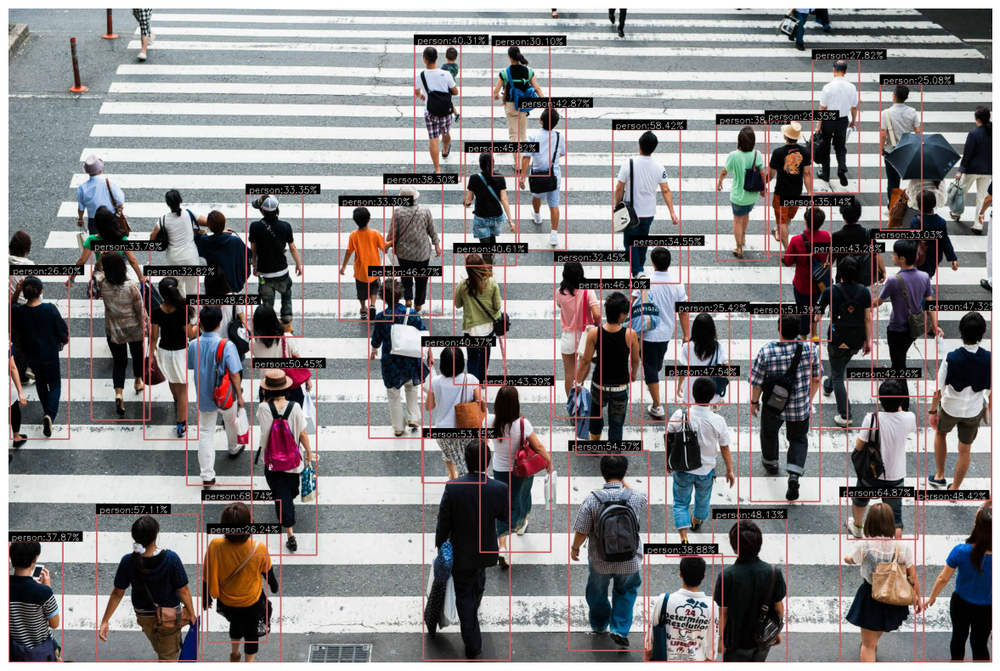

In [19]:
import tensorflow as tf
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(r"C:\Users\dhika\Downloads\pred.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = tf.expand_dims(img, axis=0)
img = tf.cast(img, tf.uint8)

results = od_model(img)
results = {key: value.numpy() for key, value in results.items()}

image = np.squeeze(img[0])
person_count, img_bbox = process_det_person(image, results, min_det_thresh=0.25)

plt.figure(figsize=[15, 10])
plt.imshow(img_bbox)
plt.axis('off')
plt.show()

In [20]:
max_person_count = 0
max_timestamp = None

def process_det_person_vid(image, results, timestamp, min_det_thresh=.5):
    global max_person_count
    global max_timestamp

    person_count = 0    
    scores = results['detection_scores'][0]
    boxes = results['detection_boxes'][0]
    classes = (results['detection_classes'][0]).astype(int)
    
    min_det_thresh = min_det_thresh
    indices_det = np.where (scores>=min_det_thresh)[0]
    

    scores_thres = scores[indices_det]
    boxes_thres = boxes[indices_det]
    classes_thres = classes[indices_det]

    font_scale = .6
    box_thickness = 2

    img_bbox = image.copy()
    im_height,im_width = image.shape[:2]
    
    for box, class_id, score in zip(boxes_thres,classes_thres,scores_thres):
        ymin,xmin,ymax,xmax = box
        class_name = index_classes[class_id]

        if class_name == 'person':
            person_count += 1

            (left,right,top,bottom) = (int(xmin*im_width),
                                   int(xmax*im_width),
                                   int(ymin*im_height),
                                   int(ymax*im_height))
        
            color = tuple(COLOR_IDS[class_id % len(COLOR_IDS)].tolist())[::-1]
            img_bbox = cv2.rectangle(img_bbox,(left,top),(right,bottom), color, thickness=box_thickness)

            display_txt = '{}:{:.2f}%'.format(class_name,100*score)
            ((text_width,text_height),_) = cv2.getTextSize(display_txt,cv2.FONT_HERSHEY_SIMPLEX,font_scale,1)

            if top < text_height:
                shift_down = int(2*(1.3*text_height))
            else :
                shift_down =0

            img_bbox = cv2.rectangle (img_bbox,
                                  (left-1, top-box_thickness-int(1.3*text_height)+shift_down),
                                  (left-1+int(1.1*text_width),top),
                                  color=(0,0,0),
                                  thickness=-1)

            img_bbox = cv2.putText(img_bbox,
                               display_txt,
                               (left + int(.05*text_width), top - int(0.2*text_height)+int(shift_down/2)),
                               cv2.FONT_HERSHEY_SIMPLEX, font_scale,(255,255,255),1)

    timestamp_txt = 'Timestamp: {:.2f}s'.format(timestamp)
    cv2.rectangle(img_bbox, (5, 5), (text_width + 40, 5 + text_height + 10), (0, 0, 0), -1)
    img_bbox = cv2.putText(img_bbox, timestamp_txt, (10, 20), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), 1)

    if person_count > max_person_count:
        max_person_count = person_count
        max_timestamp = timestamp

    print('Highest Detected:', max_person_count, max_timestamp)
    print('Total Person Detected:', person_count)
    return person_count, img_bbox

Highest Detected: 18 0.0
Total Person Detected: 18


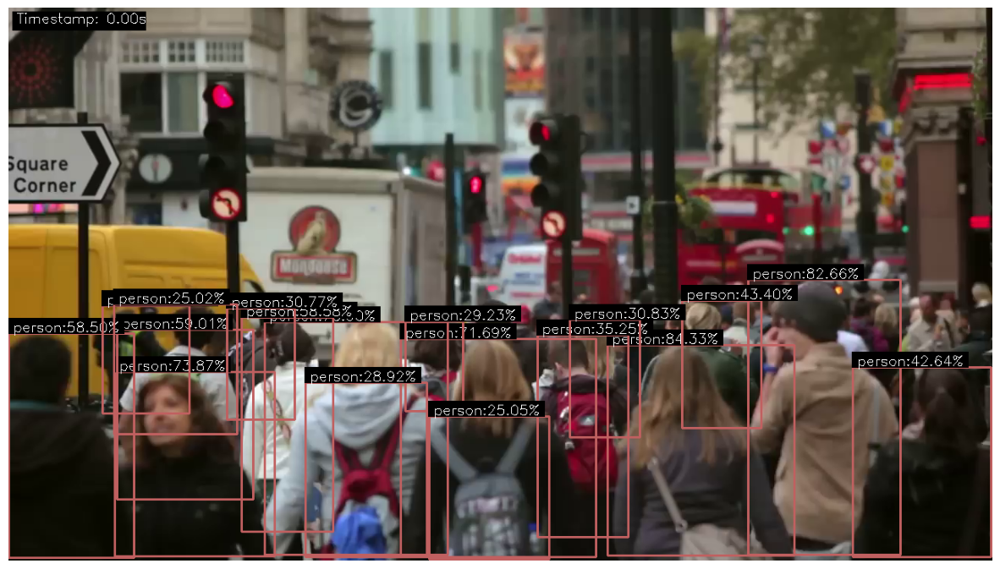

Highest Detected: 18 0.0
Total Person Detected: 17


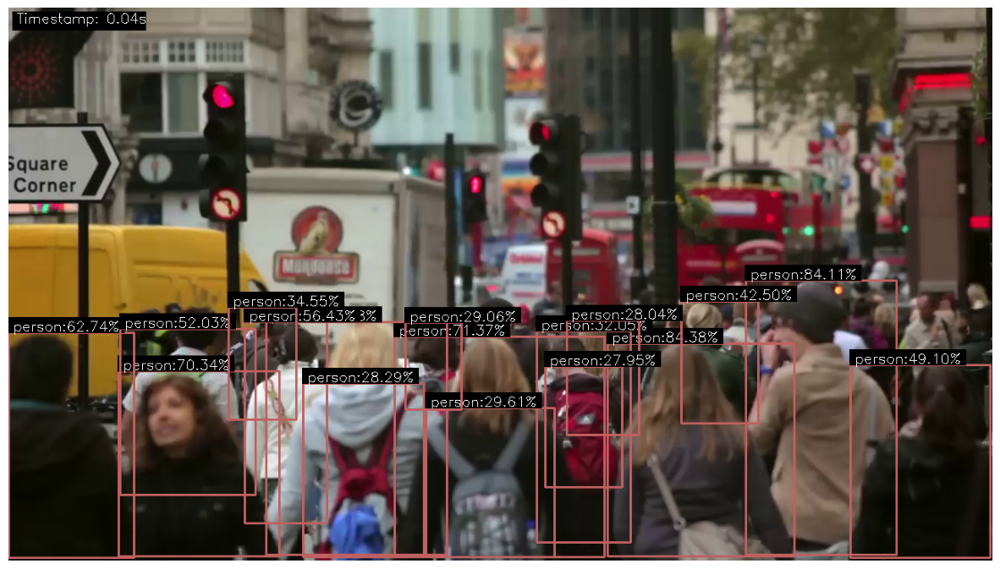

Highest Detected: 18 0.0
Total Person Detected: 16


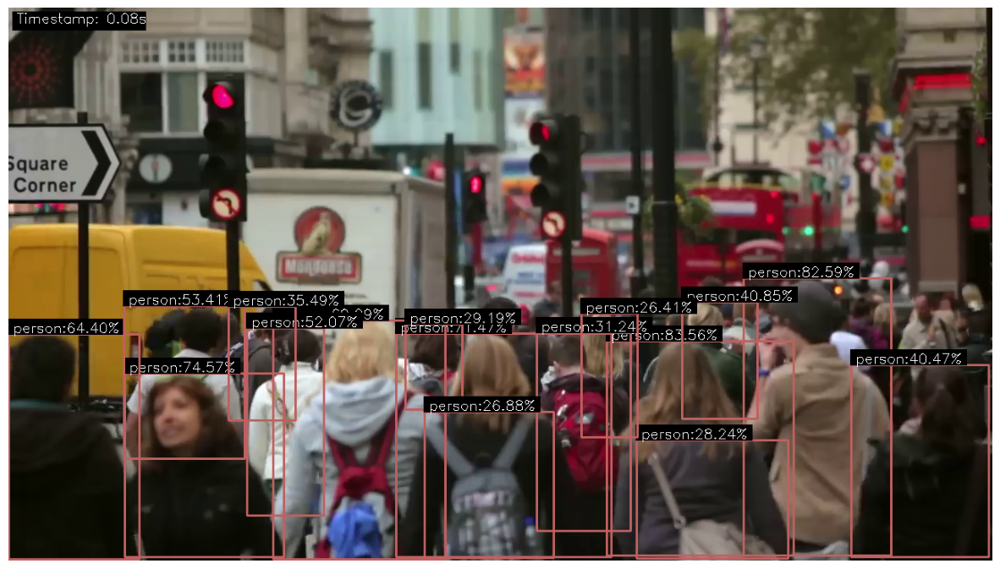

Highest Detected: 18 0.0
Total Person Detected: 15


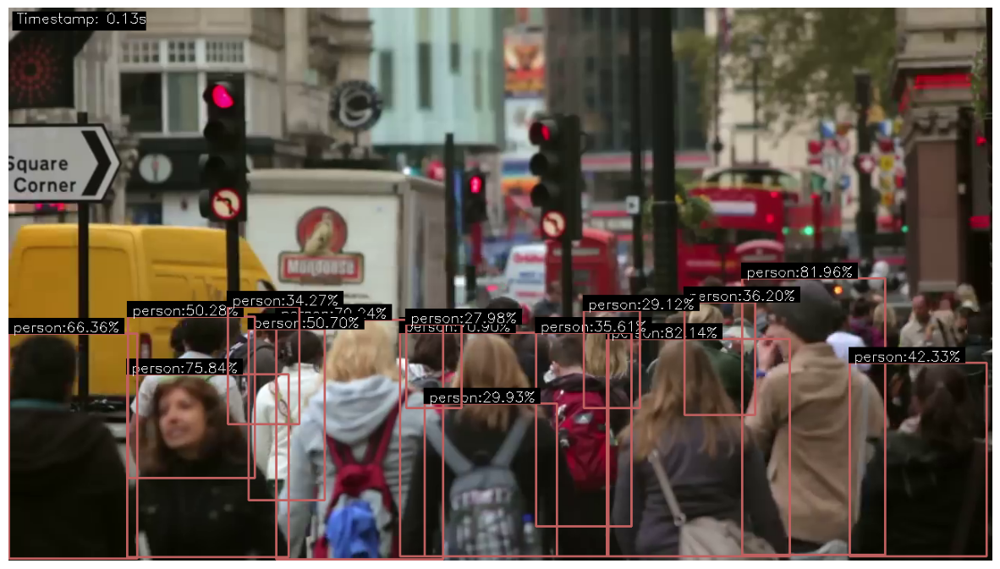

Highest Detected: 18 0.0
Total Person Detected: 17


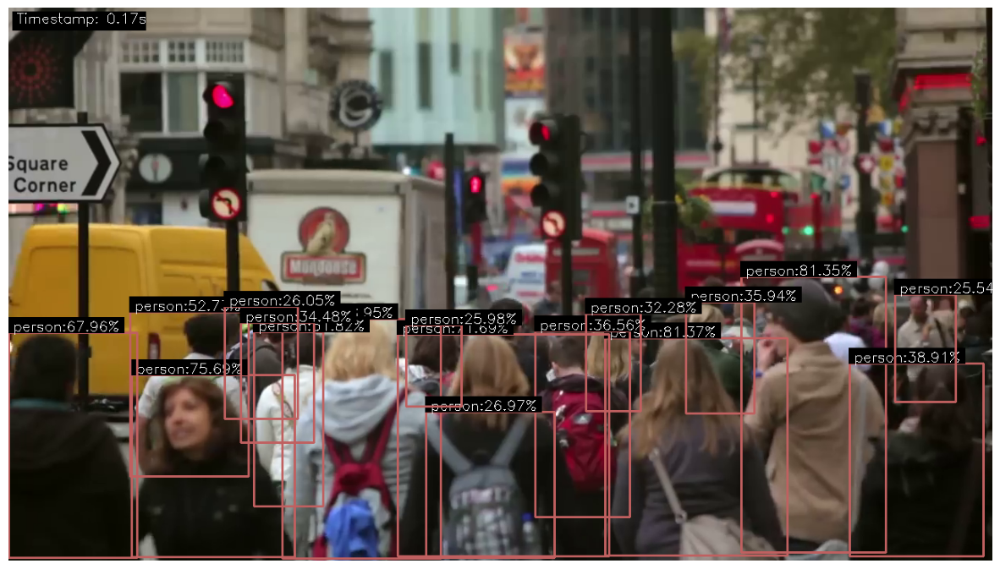

Highest Detected: 18 0.0
Total Person Detected: 16


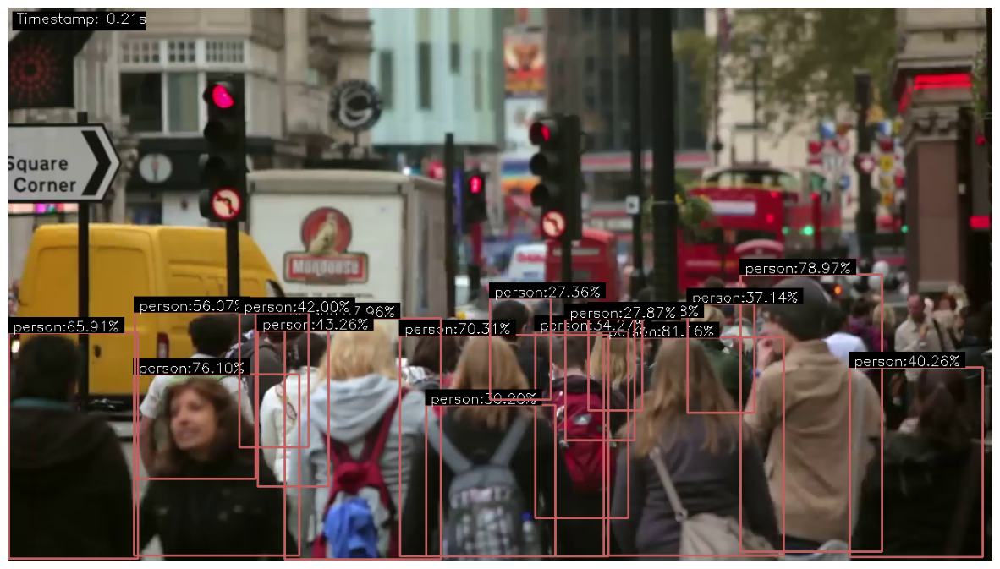

In [21]:
cap = cv2.VideoCapture(r"D:\Busypeople.mp4")

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame = tf.expand_dims(frame, axis=0)
    frame = tf.cast(frame, tf.uint8)

    results = od_model(frame)
    results = {key: value.numpy() for key, value in results.items()}

    timestamp = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000

    image = np.squeeze(frame[0])
    person_count, img_bbox = process_det_person_vid(image, results, timestamp, min_det_thresh=0.25)

    cv2.imshow('Video',img_bbox)

    plt.figure(figsize=[15, 10])
    plt.imshow(img_bbox)
    plt.axis('off')
    plt.show()

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

In [22]:
import datetime
max_person_count = 0
max_timestamp = datetime.datetime.now()
def process_det_person_cam(image, results, timestamp, min_det_thresh=.75):
    global max_person_count
    global max_timestamp

    person_count = 0    
    scores = results['detection_scores'][0]
    boxes = results['detection_boxes'][0]
    classes = (results['detection_classes'][0]).astype(int)
    
    min_det_thresh = min_det_thresh
    indices_det = np.where (scores>=min_det_thresh)[0]
    

    scores_thres = scores[indices_det]
    boxes_thres = boxes[indices_det]
    classes_thres = classes[indices_det]

    font_scale = .6
    box_thickness = 2

    img_bbox = image.copy()
    im_height,im_width = image.shape[:2]
    
    for box, class_id, score in zip(boxes_thres,classes_thres,scores_thres):
        ymin,xmin,ymax,xmax = box
        class_name = index_classes[class_id]

        if class_name == 'person':
            person_count += 1
            (left,right,top,bottom) = (int(xmin*im_width),
                                   int(xmax*im_width),
                                   int(ymin*im_height),
                                   int(ymax*im_height))
        
            color = tuple(COLOR_IDS[class_id % len(COLOR_IDS)].tolist())[::-1]
            img_bbox = cv2.rectangle(img_bbox,(left,top),(right,bottom), color, thickness=box_thickness)

            display_txt = '{}:{:.2f}%'.format(class_name,100*score)
            ((text_width,text_height),_) = cv2.getTextSize(display_txt,cv2.FONT_HERSHEY_SIMPLEX,font_scale,1)

        if top < text_height:
            shift_down = int(2*(1.3*text_height))
        else :
            shift_down =0

        img_bbox = cv2.rectangle (img_bbox,
                                  (left-1, top-box_thickness-int(1.3*text_height)+shift_down),
                                  (left-1+int(1.1*text_width),top),
                                  color=(0,0,0),
                                  thickness=-1)
        
        img_bbox = cv2.putText(img_bbox,
                               display_txt,
                               (left + int(.05*text_width), top - int(0.2*text_height)+int(shift_down/2)),
                               cv2.FONT_HERSHEY_SIMPLEX, font_scale,(255,255,255),1)

    current_time = datetime.datetime.now()
    timestamp_str = current_time.strftime("%Y-%m-%d %H:%M:%S")

    cv2.rectangle(img_bbox, (420, 20), (2500, 5), (0, 0, 0), -1)
    img_bbox = cv2.putText(img_bbox, timestamp_str, (420, 20), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 0, 255), 1)

    if person_count > max_person_count:
        max_person_count = person_count
        max_timestamp = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        
    print('Highest Detected:', max_person_count, max_timestamp)
    print('Total Person Detected:', person_count)
    return person_count, img_bbox

Highest Detected: 1 2024-09-08 17:15:27
Total Person Detected: 1
Highest Detected: 1 2024-09-08 17:15:27
Total Person Detected: 1
Highest Detected: 1 2024-09-08 17:15:27
Total Person Detected: 1


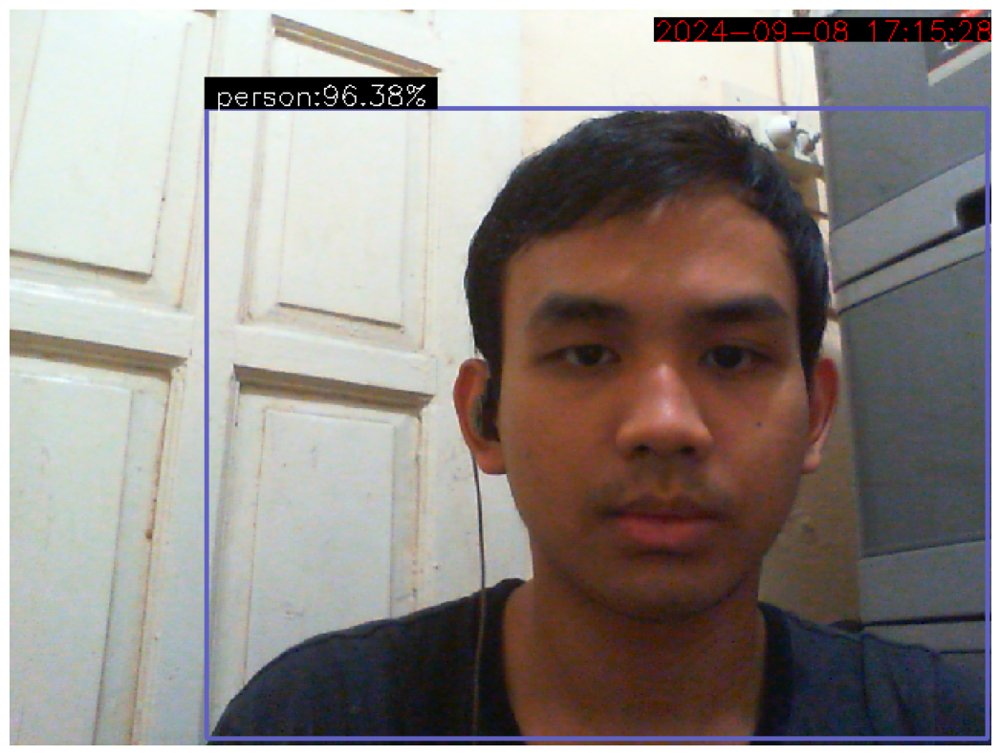

In [23]:
import datetime
cap = cv2.VideoCapture(0)

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame = tf.expand_dims(frame, axis=0)
    frame = tf.cast(frame, tf.uint8)

    results = od_model(frame)
    results = {key: value.numpy() for key, value in results.items()}

    current_time = datetime.datetime.now()
    timestamp_str = current_time.strftime("%Y-%m-%d %H:%M:%S")

    image = np.squeeze(frame[0])
    person_count, img_bbox = process_det_person_cam(image, results, timestamp_str, min_det_thresh=0.25)

    cv2.imshow('Video', img_bbox)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    
cap.release()
cv2.destroyAllWindows()

plt.figure(figsize=[15,10])
plt.imshow(cv2.cvtColor(img_bbox, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()